In [1]:
import osmnx as ox
import networkx as nx
import matplotlib.pyplot as plt
import momepy

In [2]:
# Define place name
place_name = "Los Angeles, California, USA"

# Download power network data from OpenStreetMap
# The key='power' will get elements tagged as power infrastructure
tags = {'power': True}
gdf = ox.features_from_place(place_name, tags=tags)

print(f"Retrieved {len(gdf)} power-related features")




Retrieved 8554 power-related features


In [3]:
gdf['power'].value_counts()

power
pole             4568
tower            1187
generator         931
line              775
minor_line        668
substation        174
transformer       153
plant              40
cable              32
portal             12
catenary_mast       6
yes                 4
connection          2
compensator         1
switchgear          1
Name: count, dtype: int64

In [4]:
# Get rid of 'element' in gdf index
gdf = gdf.reset_index(drop=False)
gdf = gdf.set_index('id')

In [5]:
# Filter for relevant power features (optional)
lines = gdf[gdf['power'].isin(['line', 'minor_line'])]
# nodes = gdf[gdf['power'].isin(['substation', 'generator', 'plant', 'transformer'])]
nodes = gdf[~gdf['power'].isin(['line', 'minor_line'])]
print(f"Lines: {len(lines)}, Nodes: {len(nodes)}")


Lines: 1443, Nodes: 7111


In [6]:
map = lines.explore(column='power')
nodes.explore(m=map, column='power')
map

In [ ]:
#Convert lines and nodes to a NetworkX graph
# We'll connect lines to nearest nodes at their endpoints
G = nx.Graph()

# Add node attributes
for idx, row in nodes.iterrows():
    if row.geometry.geom_type == 'Point':
        G.add_node(idx,
                   geometry=row.geometry,
                   power_type=row.get('power', None),
                   name=row.get('name', None))
    elif row.geometry.geom_type == 'Polygon':
        G.add_node(idx,
                   geometry=row.geometry.centroid,
                   power_type=row.get('power', None),
                   name=row.get('name', None))
# Add edges using the line geometries
for idx, row in lines.iterrows():
    line = row.geometry
    start_point = line.coords[0]
    end_point = line.coords[-1]
    G.add_edge(start_point, end_point,
               geometry=line,
               power_type=row.get('power', None),
               voltage=row.get('voltage', None),
               circuits=row.get('circuits', None))

print(f"Graph built with {len(G.nodes)} nodes and {len(G.edges)} edges")


Graph built with 94 nodes and 48 edges


In [8]:
nodes

,element,geometry,power,source,material,line_attachment,generator:method,generator:output:electricity,generator:source,generator:type,...,operator:wikidata,operator:wikipedia,location,substation,plant:output:electricity,landuse,plant:method,plant:source,ref:US:EIA,wikidata
id,,,,,,,,,,,,,,,,,,,,,
9843003595,node,POINT (-118.14955 34.12686),generator,U.S. Energy Information Administration - EIA-8...,NaN,NaN,combustion,16 MW,gas,steam_turbine,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9843003596,node,POINT (-118.14955 34.12669),generator,U.S. Energy Information Administration - EIA-8...,NaN,NaN,combustion,71 MW,gas,gas_turbine,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9843003597,node,POINT (-118.14861 34.12666),generator,U.S. Energy Information Administration - EIA-8...,NaN,NaN,combustion,28.8 MW,gas,gas_turbine,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9843003598,node,POINT (-118.14889 34.12666),generator,U.S. Energy Information Administration - EIA-8...,NaN,NaN,combustion,28.8 MW,gas,gas_turbine,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9843003599,node,POINT (-118.1493 34.12608),generator,U.S. Energy Information Administration - EIA-8...,NaN,NaN,combustion,60.5 MW,gas,gas_turbine,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9843003600,node,POINT (-118.14931 34.12626),generator,U.S. Energy Information Administration - EIA-8...,NaN,NaN,combustion,60.5 MW,gas,gas_turbine,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11630702389,node,POINT (-118.08837 34.15083),transformer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11630702390,node,POINT (-118.08822 34.15083),transformer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11630702393,node,POINT (-118.08807 34.1508),transformer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [7]:
print("Node indices:")
for i, node in enumerate(G.nodes()):
    print(i, node)

Node indices:
0 9843003595
1 9843003596
2 9843003597
3 9843003598
4 9843003599
5 9843003600
6 11630702389
7 11630702390
8 11630702393
9 39515679
10 169880227
11 169880237
12 233472857
13 414575296
14 458801027
15 460122549
16 460122550
17 460122551
18 460122722
19 473918745
20 686377343
21 (-118.1852932, 34.2209652)
22 (-118.0868954, 34.1512313)
23 (-118.1836822, 34.1468474)
24 (-118.1828934, 34.1490356)
25 (-118.1863905, 34.1382829)
26 (-118.183384, 34.1483849)
27 (-118.1819273, 34.2199711)
28 (-118.0933191, 34.1861587)
29 (-118.1231288, 34.4839338)
30 (-118.1869555, 34.2223634)
31 (-118.1832018, 34.1486394)
32 (-118.1853777, 34.22071)
33 (-118.1129507, 34.0369933)
34 (-118.0857499, 34.1579033)
35 (-118.0858969, 34.1619503)
36 (-118.0859422, 34.162)
37 (-118.0876343, 34.151321)
38 (-118.0877422, 34.151211)
39 (-118.0861488, 34.1559671)
40 (-118.0876928, 34.151462)
41 (-118.0867878, 34.1447471)
42 (-118.0867104, 34.1447802)
43 (-118.1123729, 34.0369775)
44 (-118.0927668, 34.172401)
45 

In [17]:
# Convert to GeoDataFrames
nodes_gdf, edges_gdf = momepy.nx_to_gdf(G)

/tmp/ipykernel_222837/3476957755.py:2: UserWarning: Approach is not set. Defaulting to 'primal'.
  nodes_gdf, edges_gdf = momepy.nx_to_gdf(G)


TypeError: shapely.geometry.point.Point() argument after * must be an iterable, not int

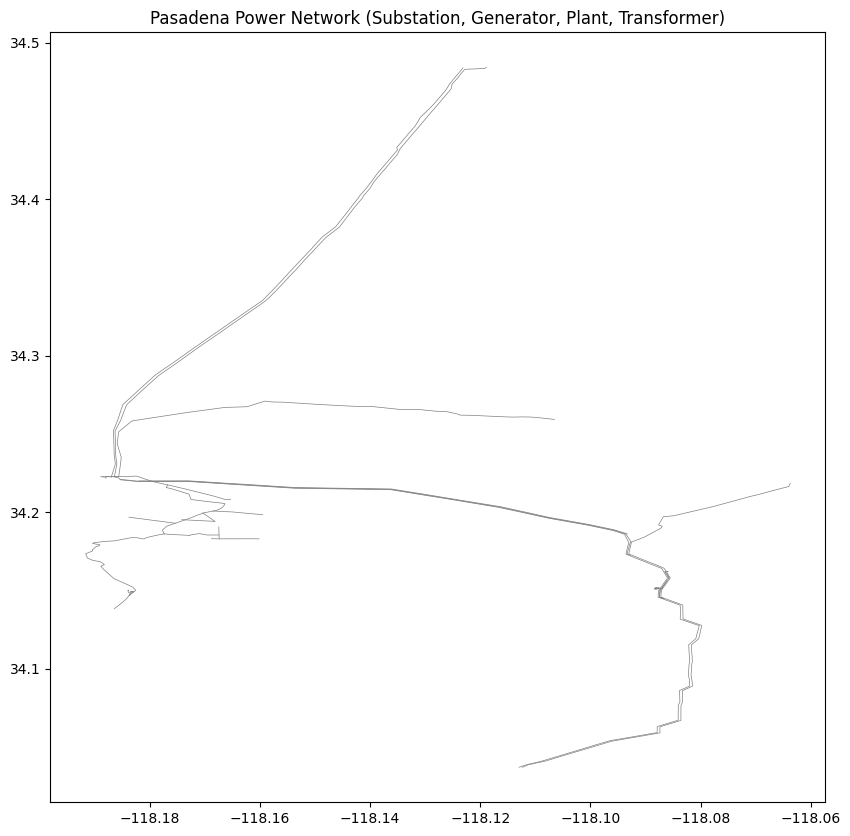

In [11]:
# Visualize
fig, ax = plt.subplots(figsize=(10, 10))
for u, v, data in G.edges(data=True):
    geom = data['geometry']
    ax.plot(*geom.xy, color='gray', linewidth=0.5)
# for n, data in G.nodes(data=True):
#     if 'geometry' not in data:
#         print(f"Node {n} missing geometry, skipping.")
#         print(data)
#         continue
#     geom = data['geometry']
#     ax.scatter(geom.x, geom.y, s=20,
#                label=data['power_type'] if 'power_type' in data else 'unknown')
plt.title("Pasadena Power Network (Substation, Generator, Plant, Transformer)")
plt.show()
